<a href="https://colab.research.google.com/github/Mike030668/MIPT_magistratura/blob/main/Text2Video_project/experiments/Report_kandinsky22_text_rotation_dreif_latent_experiments_cropsquare_depth.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Kandinsky

https://habr.com/ru/companies/sberbank/articles/725282/

In [ ]:
!pip install git+https://github.com/huggingface/diffusers.git -q
!git clone https://github.com/lllyasviel/ControlNet -q
!pip install einops -q
!pip install timm -q
!pip install transformers -q
!pip install basicsr -q
!pip install accelerate -q

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.6/44.6 kB 708.6 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 15.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 172.5/172.5 kB 5.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 299.2/299.2 kB 12.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 31.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 254.7/254.7 kB 30.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 39.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 265.7/265.7 kB 5.6 MB/s eta 0:00:00


In [ ]:
import torch
torch.__version__

'2.1.0+cu118'

In [ ]:
import sys
sys.path.append('/content/ControlNet/')
from diffusers import KandinskyV22Pipeline, KandinskyV22PriorPipeline
import PIL
from torchvision import transforms
from transformers import CLIPVisionModelWithProjection
from diffusers.models import UNet2DConditionModel
import numpy as np

DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

## Kandinsky encoder

https://huggingface.co/docs/diffusers/api/pipelines/kandinsky_v22

https://github.com/huggingface/diffusers/blob/main/src/diffusers/pipelines/kandinsky2_2/pipeline_kandinsky2_2.py

In [ ]:
clip_name = 'kandinsky-community/kandinsky-2-2-prior'
TYPE_TENSORS = torch.float16

image_encoder = CLIPVisionModelWithProjection.from_pretrained(clip_name,
                                                              subfolder='image_encoder'
                                                              )
image_encoder.to(TYPE_TENSORS).to(DEVICE)

prior_T2I = KandinskyV22PriorPipeline.from_pretrained(clip_name,
                                                      image_encoder=image_encoder,
                                                      torch_dtype=TYPE_TENSORS)
prior_T2I.to(DEVICE)

model_index.json:   0%|          | 0.00/501 [00:00<?, ?B/s]

Fetching 11 files:   0%|          | 0/11 [00:00<?, ?it/s]

scheduler/scheduler_config.json:   0%|          | 0.00/229 [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/2.02k [00:00<?, ?B/s]

prior/config.json:   0%|          | 0.00/252 [00:00<?, ?B/s]

image_processor/preprocessor_config.json:   0%|          | 0.00/315 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/904 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/862k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/2.78G [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/4.10G [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

KandinskyV22PriorPipeline {
  "_class_name": "KandinskyV22PriorPipeline",
  "_diffusers_version": "0.25.0.dev0",
  "_name_or_path": "kandinsky-community/kandinsky-2-2-prior",
  "image_encoder": [
    "transformers",
    "CLIPVisionModelWithProjection"
  ],
  "image_processor": [
    "transformers",
    "CLIPImageProcessor"
  ],
  "prior": [
    "diffusers",
    "PriorTransformer"
  ],
  "scheduler": [
    "diffusers",
    "UnCLIPScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModelWithProjection"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ]
}

## Kandinsky decoder T2I

In [ ]:
decoder_name = 'kandinsky-community/kandinsky-2-2-decoder'

unet_T2I = UNet2DConditionModel.from_pretrained(
    decoder_name,
    subfolder='unet'
).half().to(DEVICE)

decoder_T2I = KandinskyV22Pipeline.from_pretrained(
    decoder_name,
    unet=unet_T2I,
    torch_dtype=TYPE_TENSORS
).to(DEVICE)


BATCH_SIZE = 1
HEIGHT = 512
WIDTH = 512
SHAPE_NOISE = (BATCH_SIZE, unet_T2I.in_channels, HEIGHT // 8, WIDTH // 8)


# Clear memory

In [ ]:
try: del unet_T2I, image_encoder
except: pass

import gc
gc.collect()
torch.cuda.empty_cache()
torch.cuda.memory_summary(device=DEVICE, abbreviated=False)

'|===========================================================================|\n|                  PyTorch CUDA memory summary, device ID 0                 |\n|---------------------------------------------------------------------------|\n|            CUDA OOMs: 2            |        cudaMalloc retries: 2         |\n|===========================================================================|\n|        Metric         | Cur Usage  | Peak Usage | Tot Alloc  | Tot Freed  |\n|---------------------------------------------------------------------------|\n| Allocated memory      |  12298 MiB |  14450 MiB | 520678 MiB | 508379 MiB |\n|       from large pool |  12217 MiB |  14367 MiB | 174445 MiB | 162227 MiB |\n|       from small pool |     81 MiB |     91 MiB | 346233 MiB | 346152 MiB |\n|---------------------------------------------------------------------------|\n| Active memory         |  12298 MiB |  14450 MiB | 520678 MiB | 508379 MiB |\n|       from large pool |  12217 MiB |  14367 MiB |

# Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## MOVI SHORTS

### Film и crop в массив

на основе scikit-video

In [ ]:
!pip install scikit-video -q

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 16.4 MB/s eta 0:00:00


In [ ]:
import skvideo.io
import cv2
import os
import numpy as np
import random
from google.colab.patches import cv2_imshow
import PIL
from IPython import display

In [ ]:
video_directory = '/content/drive/...............' # your directory with move
video_list = os.listdir(video_directory)#[:2]
print(len(video_list))


53


In [ ]:
FILM_ID = 28
videodata = skvideo.io.vread(video_directory + video_list[FILM_ID])
print(videodata.shape)

name_film = video_directory + video_list[FILM_ID]
name_film = name_film.split('.')[0]
name_film = name_film.split('.')[0].split('/')[2]
print(name_film)

(220, 540, 960, 3)
drive


Number of frames: 220
Number of rows: 600
Number of cols: 1200
Number of channels: 3


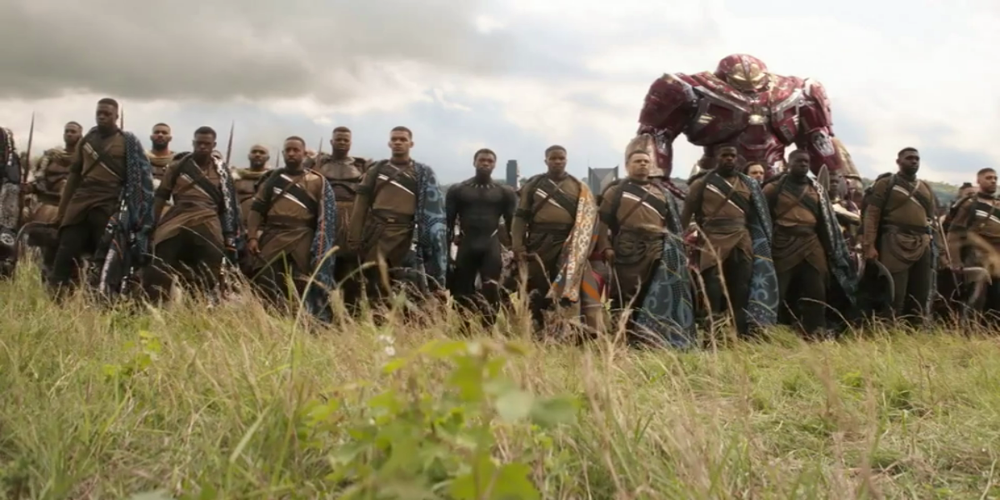

In [ ]:
# upscale frame from the bigbuckbunny sequence by a factor of 2
VIDEO_WIDTH = 1200 #1024
VIDEO_HEIGHT = 600 #512
vid = skvideo.io.vread(video_directory + video_list[FILM_ID],
                       outputdict={
                           "-sws_flags": "bilinear",
                           "-s": f"{VIDEO_WIDTH}x{VIDEO_HEIGHT}"
                       }
)
T, M, N, C = vid.shape

print("Number of frames: %d" % (T,))
print("Number of rows: %d" % (M,))
print("Number of cols: %d" % (N,))
print("Number of channels: %d" % (C,))

id_frame_1 = 10
frame_1 =   vid[id_frame_1]
cv2_imshow(frame_1[...,::-1])

In [ ]:
def get_embeddings(pil_img):
  return prior_T2I.interpolate(images_and_prompts=[pil_img],
                                 weights=[1],
                                 num_images_per_prompt=1
                                 ).image_embeds


In [ ]:
pil_img = PIL.Image.fromarray(frame_1)
clip_img_emb = get_embeddings(pil_img)
clip_img_emb.shape

  0%|          | 0/25 [00:00<?, ?it/s]

torch.Size([1, 1280])

In [ ]:
#import os
#os.environ["PYTORCH_CUDA_ALLOC_CONF"] = "max_split_size_mb:512"

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity

def getcrop_cosine_sim_frames(
              film: object,
              wait_frames:int,
              level:float = 0,
              loose_stop:int = 5,
              step_drift:int = 1,
              width_crop = 512,
              height_crop = 512,
              qty_wait = 10,
              size_dreif = 2,
              ):

    # inition
    already_selected = 0
    lose_select = 0
    current_id = 0
    (height_frane, width_frane) = film[0].shape[:2]

    # proportion between width_frane/height_frane
    coef = width_frane/height_frane


    # started crop frame parametrs
    waiting_width_dreif = 0
    waiting_height_dreif = 0
    # dreif by width
    dreif_width_center = 0
    direction_width_dreif = random.choice((-1, 0, 1))
    center_width = width_frane//2 + dreif_width_center*direction_width_dreif
    left = center_width - width_crop//2
    right = center_width + width_crop//2

    # dreif by height
    dreif_height_center = 0
    direction_height_dreif = random.choice((-1, 0, 1))
    center_height = height_frane//2 + dreif_height_center*direction_height_dreif
    down = center_height - height_crop//2
    up = center_height + height_crop//2

    # take from from film
    print('film[current_id].shape = ', film[current_id].shape)
    start_image = film[current_id][down:up, left:right, :]
    print('start_image.shape = ', start_image.shape)
    start_pil_image = PIL.Image.fromarray(start_image)
    #clip_vector_start = np.arange(768)[None]
    clip_vector_start = get_embeddings(start_pil_image).cpu().numpy()
    print('left, right = ', left,right)
    print('down, up = ', down, up)

    # append datas
    flatten_frames = [start_image.flatten()]
    emmbedings = [clip_vector_start[0]]
    original_frames = [start_pil_image]

    # update crop frame parametrs
    dreif_width_center+=size_dreif
    # if height low than width , than it wil changed slowly
    dreif_height_center+= int(size_dreif//coef)

    sim_with_start = [1]
    sim_with_earlier = [1]

    # go by frames
    for step in range(len(film)):

      waiting_width_dreif += 1
      waiting_height_dreif += 1

      if waiting_width_dreif > qty_wait:
        direction_width_dreif = random.choice((-1, 0, 1))
        waiting_width_dreif = 0

      if waiting_height_dreif > qty_wait:
        direction_height_dreif = random.choice((-1, 0, 1))
        waiting_height_dreif = 0


      if (center_width + dreif_width_center*direction_width_dreif - width_crop//2) < dreif_width_center or \
       (center_width + dreif_width_center*direction_width_dreif + width_crop//2) > width_frane-dreif_width_center:

        direction_width_dreif*=-1
        waiting_width_dreif = 0

      center_width += dreif_width_center*direction_width_dreif
      left = center_width - width_crop//2
      right = center_width + width_crop//2

      print('left, right = ', left,right)

      if (center_height + dreif_height_center*direction_height_dreif - height_crop//2) < dreif_height_center or \
       (center_height + dreif_height_center*direction_height_dreif + height_crop//2) > height_frane-dreif_height_center:

        direction_height_dreif*=-1
        waiting_height_dreif = 0

      center_height += dreif_height_center*direction_height_dreif
      down = center_height - height_crop//2
      up = center_height + height_crop//2

      print('centr w,h = ', center_width, center_height)

      print('down, up = ', down, up)

      # update id
      current_id += step_drift
      if current_id > len(film) - step_drift:
        print("The End film")
        break

      # take from from film
      print('film[current_id].shape = ', film[current_id].shape)
      current_frame  =  film[current_id][down:up, left:right, :]
      print('current_frame.shape = ', current_frame.shape)
      pil_image = PIL.Image.fromarray(current_frame)
      #clip_vector = np.arange(768)[None]
      clip_vector = get_embeddings(pil_image).cpu().numpy()


      # if try select closes by prompts
      if level:
          similirity = cosine_similarity(clip_vector,  clip_vector_start)[0][0]

      # if take all
      else: similirity = 1


      print(f'cos_similirity of step {step} = {similirity}')

      if similirity > level:
        lose_select = 0
        emmbedings.append(clip_vector[0])
        flatten_frames.append(current_frame.flatten())
        original_frames.append(pil_image)
        already_selected = len(emmbedings)
        print(f'take frame, already_selected {already_selected}')

        sim_with_start.append(similirity)
        # calculate similirity with prev
        similirity = cosine_similarity(clip_vector, emmbedings[-1][None])[0][0]
        sim_with_earlier.append(similirity)

      else: lose_select+=1
      print()
      if already_selected == wait_frames or lose_select> loose_stop: break

    del(clip_vector, current_frame, pil_image)
    gc.collect()
    torch.cuda.empty_cache()
    torch.cuda.memory_summary(device=DEVICE, abbreviated=False)

    return original_frames, emmbedings, flatten_frames, sim_with_start, sim_with_earlier

In [ ]:
import glob
import PIL
import base64
from IPython import display

def make_gif(set_dir_pil, out_name = "my_awesome.gif", duration = 10, loop=0, ext = '/*.JPG'):

    if type(set_dir_pil) == str:
       frames = [PIL.Image.open(image) for image in glob.glob(f"{set_dir_pil}{ext}")]

    elif type(set_dir_pil) == list: frames = set_dir_pil

    frame_one = frames[0]
    frame_one.save(out_name, format="GIF", append_images=frames,
               save_all=True, duration=duration, loop=loop)


def show_gif(fname):

    with open(fname, 'rb') as fd:
        b64 = base64.b64encode(fd.read()).decode('ascii')
    return display.HTML(f'<img src="data:image/gif;base64,{b64}" />')

### Get croped frames

In [ ]:
COS_SIM = 0.8
TAKE_EACH = 2
SIZE_DREIF = 2
pil_frames, img_emmbedings, flat_data, sim2start, sim2prev  = getcrop_cosine_sim_frames(
                                                                film = vid, #[5:],
                                                                level = COS_SIM,
                                                                step_drift = TAKE_EACH,
                                                                wait_frames = 25,
                                                                qty_wait = 12,   # parametr
                                                                size_dreif = SIZE_DREIF,  # parametr
                                                                width_crop = WIDTH,
                                                                height_crop = HEIGHT,
                                                                )

film[current_id].shape =  (600, 1200, 3)
start_image.shape =  (512, 512, 3)


  0%|          | 0/25 [00:00<?, ?it/s]

left, right =  344 856
down, up =  44 556
left, right =  342 854
centr w,h =  598 301
down, up =  45 557
film[current_id].shape =  (600, 1200, 3)
current_frame.shape =  (512, 512, 3)


  0%|          | 0/25 [00:00<?, ?it/s]

cos_similirity of step 0 = 0.9923063930050282
take frame, already_selected 2

left, right =  340 852
centr w,h =  596 302
down, up =  46 558
film[current_id].shape =  (600, 1200, 3)
current_frame.shape =  (512, 512, 3)


  0%|          | 0/25 [00:00<?, ?it/s]

cos_similirity of step 1 = 0.9904866541604965
take frame, already_selected 3

left, right =  338 850
centr w,h =  594 303
down, up =  47 559
film[current_id].shape =  (600, 1200, 3)
current_frame.shape =  (512, 512, 3)


  0%|          | 0/25 [00:00<?, ?it/s]

cos_similirity of step 2 = 0.9826364916538812
take frame, already_selected 4

left, right =  336 848
centr w,h =  592 304
down, up =  48 560
film[current_id].shape =  (600, 1200, 3)
current_frame.shape =  (512, 512, 3)


  0%|          | 0/25 [00:00<?, ?it/s]

cos_similirity of step 3 = 0.9817562628656736
take frame, already_selected 5

left, right =  334 846
centr w,h =  590 305
down, up =  49 561
film[current_id].shape =  (600, 1200, 3)
current_frame.shape =  (512, 512, 3)


  0%|          | 0/25 [00:00<?, ?it/s]

cos_similirity of step 4 = 0.9792325580349037
take frame, already_selected 6

left, right =  332 844
centr w,h =  588 306
down, up =  50 562
film[current_id].shape =  (600, 1200, 3)
current_frame.shape =  (512, 512, 3)


  0%|          | 0/25 [00:00<?, ?it/s]

cos_similirity of step 5 = 0.9810534062917269
take frame, already_selected 7

left, right =  330 842
centr w,h =  586 307
down, up =  51 563
film[current_id].shape =  (600, 1200, 3)
current_frame.shape =  (512, 512, 3)


  0%|          | 0/25 [00:00<?, ?it/s]

cos_similirity of step 6 = 0.9803970511650485
take frame, already_selected 8

left, right =  328 840
centr w,h =  584 308
down, up =  52 564
film[current_id].shape =  (600, 1200, 3)
current_frame.shape =  (512, 512, 3)


  0%|          | 0/25 [00:00<?, ?it/s]

cos_similirity of step 7 = 0.9784323978418826
take frame, already_selected 9

left, right =  326 838
centr w,h =  582 309
down, up =  53 565
film[current_id].shape =  (600, 1200, 3)
current_frame.shape =  (512, 512, 3)


  0%|          | 0/25 [00:00<?, ?it/s]

cos_similirity of step 8 = 0.9748360471427321
take frame, already_selected 10

left, right =  324 836
centr w,h =  580 310
down, up =  54 566
film[current_id].shape =  (600, 1200, 3)
current_frame.shape =  (512, 512, 3)


  0%|          | 0/25 [00:00<?, ?it/s]

cos_similirity of step 9 = 0.9800608393879329
take frame, already_selected 11

left, right =  322 834
centr w,h =  578 311
down, up =  55 567
film[current_id].shape =  (600, 1200, 3)
current_frame.shape =  (512, 512, 3)


  0%|          | 0/25 [00:00<?, ?it/s]

cos_similirity of step 10 = 0.9813052489890095
take frame, already_selected 12

left, right =  320 832
centr w,h =  576 312
down, up =  56 568
film[current_id].shape =  (600, 1200, 3)
current_frame.shape =  (512, 512, 3)


  0%|          | 0/25 [00:00<?, ?it/s]

cos_similirity of step 11 = 0.978199409102007
take frame, already_selected 13

left, right =  318 830
centr w,h =  574 312
down, up =  56 568
film[current_id].shape =  (600, 1200, 3)
current_frame.shape =  (512, 512, 3)


  0%|          | 0/25 [00:00<?, ?it/s]

cos_similirity of step 12 = 0.9773194959538365
take frame, already_selected 14

left, right =  316 828
centr w,h =  572 312
down, up =  56 568
film[current_id].shape =  (600, 1200, 3)
current_frame.shape =  (512, 512, 3)


  0%|          | 0/25 [00:00<?, ?it/s]

cos_similirity of step 13 = 0.9782425657448164
take frame, already_selected 15

left, right =  314 826
centr w,h =  570 312
down, up =  56 568
film[current_id].shape =  (600, 1200, 3)
current_frame.shape =  (512, 512, 3)


  0%|          | 0/25 [00:00<?, ?it/s]

cos_similirity of step 14 = 0.9799021413390154
take frame, already_selected 16

left, right =  312 824
centr w,h =  568 312
down, up =  56 568
film[current_id].shape =  (600, 1200, 3)
current_frame.shape =  (512, 512, 3)


  0%|          | 0/25 [00:00<?, ?it/s]

cos_similirity of step 15 = 0.9780969828284837
take frame, already_selected 17

left, right =  310 822
centr w,h =  566 312
down, up =  56 568
film[current_id].shape =  (600, 1200, 3)
current_frame.shape =  (512, 512, 3)


  0%|          | 0/25 [00:00<?, ?it/s]

cos_similirity of step 16 = 0.9701596047243817
take frame, already_selected 18

left, right =  308 820
centr w,h =  564 312
down, up =  56 568
film[current_id].shape =  (600, 1200, 3)
current_frame.shape =  (512, 512, 3)


  0%|          | 0/25 [00:00<?, ?it/s]

cos_similirity of step 17 = 0.9678824521290756
take frame, already_selected 19

left, right =  306 818
centr w,h =  562 312
down, up =  56 568
film[current_id].shape =  (600, 1200, 3)
current_frame.shape =  (512, 512, 3)


  0%|          | 0/25 [00:00<?, ?it/s]

cos_similirity of step 18 = 0.9629805002807869
take frame, already_selected 20

left, right =  304 816
centr w,h =  560 312
down, up =  56 568
film[current_id].shape =  (600, 1200, 3)
current_frame.shape =  (512, 512, 3)


  0%|          | 0/25 [00:00<?, ?it/s]

cos_similirity of step 19 = 0.9606856058175911
take frame, already_selected 21

left, right =  302 814
centr w,h =  558 312
down, up =  56 568
film[current_id].shape =  (600, 1200, 3)
current_frame.shape =  (512, 512, 3)


  0%|          | 0/25 [00:00<?, ?it/s]

cos_similirity of step 20 = 0.9643245422427218
take frame, already_selected 22

left, right =  300 812
centr w,h =  556 312
down, up =  56 568
film[current_id].shape =  (600, 1200, 3)
current_frame.shape =  (512, 512, 3)


  0%|          | 0/25 [00:00<?, ?it/s]

cos_similirity of step 21 = 0.9646333120344175
take frame, already_selected 23

left, right =  298 810
centr w,h =  554 312
down, up =  56 568
film[current_id].shape =  (600, 1200, 3)
current_frame.shape =  (512, 512, 3)


  0%|          | 0/25 [00:00<?, ?it/s]

cos_similirity of step 22 = 0.960122925996669
take frame, already_selected 24

left, right =  296 808
centr w,h =  552 312
down, up =  56 568
film[current_id].shape =  (600, 1200, 3)
current_frame.shape =  (512, 512, 3)


  0%|          | 0/25 [00:00<?, ?it/s]

cos_similirity of step 23 = 0.9614216664965414
take frame, already_selected 25




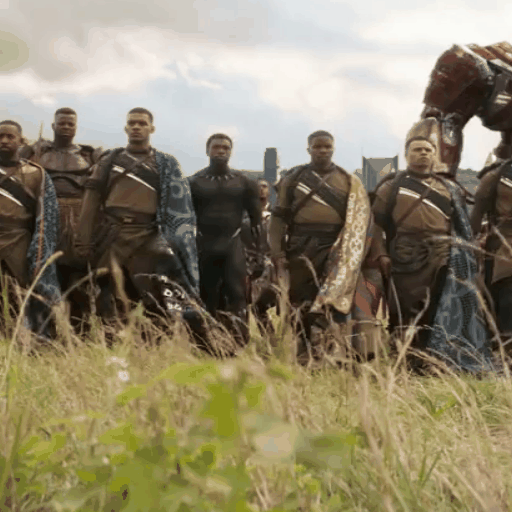

In [ ]:
fname = "selected.gif"
make_gif(pil_frames, out_name = fname)
show_gif(fname)

## Compare informations in vectors

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

movi_text = {f'cadr_{i}': img_emmbedings[i] for i in range(len(img_emmbedings))}
df_text = pd.DataFrame(movi_text, columns=list(movi_text.keys()))

corr_text = df_text.corr()
corr_text.style.background_gradient(cmap='coolwarm')

,cadr_0,cadr_1,cadr_2,cadr_3,cadr_4,cadr_5,cadr_6,cadr_7,cadr_8,cadr_9,cadr_10,cadr_11,cadr_12,cadr_13,cadr_14,cadr_15,cadr_16,cadr_17,cadr_18,cadr_19,cadr_20,cadr_21,cadr_22,cadr_23,cadr_24
cadr_0,1.000000,0.992321,0.990491,0.982636,0.981761,0.979248,0.981056,0.980399,0.978433,0.974836,0.980063,0.981307,0.978200,0.977320,0.978243,0.979902,0.978102,0.970212,0.967899,0.963002,0.960700,0.964330,0.964633,0.960125,0.961422
cadr_1,0.992321,1.000000,0.993427,0.989557,0.990346,0.988631,0.985197,0.984996,0.983065,0.981690,0.985493,0.984724,0.983642,0.983100,0.984191,0.984958,0.984690,0.983273,0.979216,0.973727,0.969625,0.971042,0.971499,0.968986,0.969592
cadr_2,0.990491,0.993427,1.000000,0.992657,0.991580,0.986691,0.989846,0.987062,0.986201,0.981692,0.985162,0.985874,0.985516,0.983196,0.985026,0.986532,0.985127,0.979093,0.975766,0.973539,0.968400,0.971385,0.973285,0.971013,0.970832
cadr_3,0.982636,0.989557,0.992657,1.000000,0.996216,0.993641,0.992589,0.990543,0.989670,0.987150,0.989555,0.986168,0.989126,0.988197,0.988609,0.988608,0.987167,0.986263,0.983757,0.982034,0.977825,0.978307,0.982287,0.980052,0.980185
cadr_4,0.981761,0.990346,0.991580,0.996216,1.000000,0.996682,0.992855,0.990496,0.990386,0.986197,0.988303,0.985692,0.988316,0.987222,0.987955,0.988405,0.987813,0.987097,0.985405,0.982723,0.979145,0.978612,0.981119,0.980199,0.980067
cadr_5,0.979248,0.988631,0.986691,0.993641,0.996682,1.000000,0.993040,0.992259,0.990393,0.987505,0.988242,0.985726,0.988004,0.988057,0.988172,0.988518,0.987711,0.988983,0.988038,0.985667,0.983992,0.982753,0.984245,0.984013,0.984150
cadr_6,0.981056,0.985197,0.989846,0.992589,0.992855,0.993040,1.000000,0.995965,0.994227,0.989426,0.990161,0.989212,0.990208,0.989256,0.989505,0.990964,0.989853,0.984722,0.984025,0.984029,0.979960,0.981884,0.985489,0.983573,0.983096
cadr_7,0.980399,0.984996,0.987062,0.990543,0.990496,0.992259,0.995965,1.000000,0.996039,0.991504,0.990405,0.989596,0.990253,0.989278,0.989030,0.989883,0.988488,0.985566,0.984668,0.984457,0.981231,0.983813,0.984966,0.983561,0.984611
cadr_8,0.978433,0.983065,0.986201,0.989670,0.990386,0.990393,0.994227,0.996039,1.000000,0.993038,0.992007,0.990292,0.991700,0.990642,0.990236,0.989649,0.988411,0.985133,0.983594,0.982547,0.979324,0.981266,0.984090,0.983861,0.985014
cadr_9,0.974836,0.981690,0.981692,0.987150,0.986197,0.987505,0.989426,0.991504,0.993038,1.000000,0.995585,0.991632,0.993672,0.989229,0.989965,0.988879,0.988477,0.987993,0.983878,0.984583,0.980715,0.981045,0.983039,0.982615,0.984100


In [ ]:
movi_frame = {f'cadr_{i}': flat_data[i] for i in range(len(flat_data))}
df_frame = pd.DataFrame(movi_frame, columns=list(movi_frame.keys()))

corr_frame = df_frame.corr()
corr_frame.style.background_gradient(cmap='coolwarm')

,cadr_0,cadr_1,cadr_2,cadr_3,cadr_4,cadr_5,cadr_6,cadr_7,cadr_8,cadr_9,cadr_10,cadr_11,cadr_12,cadr_13,cadr_14,cadr_15,cadr_16,cadr_17,cadr_18,cadr_19,cadr_20,cadr_21,cadr_22,cadr_23,cadr_24
cadr_0,1.000000,0.958890,0.921894,0.895056,0.871958,0.852180,0.832370,0.817207,0.804217,0.791725,0.778682,0.768567,0.762761,0.762840,0.759186,0.757788,0.757705,0.759342,0.754886,0.750565,0.745515,0.743530,0.741020,0.739326,0.738828
cadr_1,0.958890,1.000000,0.961417,0.923463,0.893443,0.870111,0.847669,0.831776,0.817452,0.805378,0.791736,0.781014,0.774149,0.772609,0.767638,0.764761,0.764162,0.767172,0.763910,0.758637,0.752924,0.749603,0.745506,0.742179,0.741047
cadr_2,0.921894,0.961417,1.000000,0.959345,0.918790,0.888848,0.863893,0.846008,0.830994,0.818046,0.804571,0.792836,0.786180,0.783378,0.776714,0.771738,0.769645,0.772187,0.770916,0.766634,0.760692,0.756828,0.751921,0.747721,0.745320
cadr_3,0.895056,0.923463,0.959345,1.000000,0.957160,0.916941,0.886013,0.864186,0.847260,0.833722,0.819401,0.807055,0.799706,0.796131,0.788473,0.782437,0.778835,0.779347,0.778822,0.775771,0.770153,0.765852,0.760441,0.755233,0.751347
cadr_4,0.871958,0.893443,0.918790,0.957160,1.000000,0.955442,0.912984,0.885096,0.865564,0.850046,0.834240,0.820920,0.813485,0.809050,0.800738,0.793355,0.788669,0.788001,0.786210,0.782788,0.777953,0.774425,0.768164,0.761916,0.757813
cadr_5,0.852180,0.870111,0.888848,0.916941,0.955442,1.000000,0.953059,0.915921,0.891198,0.870256,0.851665,0.838141,0.829057,0.823812,0.815533,0.807792,0.802186,0.799026,0.794490,0.790593,0.785102,0.781531,0.776311,0.770276,0.764592
cadr_6,0.832370,0.847669,0.863893,0.886013,0.912984,0.953059,1.000000,0.960948,0.924541,0.898418,0.877348,0.859910,0.847253,0.841510,0.833882,0.824448,0.819089,0.813126,0.805192,0.799741,0.794569,0.790935,0.784833,0.779033,0.774425
cadr_7,0.817207,0.831776,0.846008,0.864186,0.885096,0.915921,0.960948,1.000000,0.962655,0.927489,0.901741,0.883094,0.867655,0.858864,0.849051,0.839916,0.834510,0.827424,0.818308,0.811138,0.804875,0.799510,0.792879,0.786679,0.782319
cadr_8,0.804217,0.817452,0.830994,0.847260,0.865564,0.891198,0.924541,0.962655,1.000000,0.962142,0.927080,0.904453,0.888596,0.876947,0.864837,0.854856,0.846557,0.839799,0.830668,0.821570,0.813505,0.808125,0.800951,0.794329,0.787800
cadr_9,0.791725,0.805378,0.818046,0.833722,0.850046,0.870256,0.898418,0.927489,0.962142,1.000000,0.964647,0.931263,0.910371,0.897798,0.886062,0.873275,0.863859,0.854329,0.843094,0.833057,0.823778,0.817524,0.809889,0.802628,0.795422


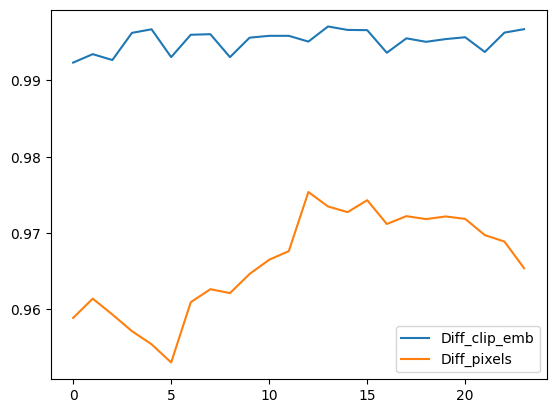

In [ ]:
plt.plot(np.arange(len(img_emmbedings)-1), [corr_text.iloc[i,i+1] for i in range(len(corr_text)-1)], label = 'Diff_clip_emb')
plt.plot(np.arange(len(flat_data)-1), [corr_frame.iloc[i,i+1] for i in range(len(corr_frame)-1)], label = 'Diff_pixels')
plt.legend()
plt.show()

# Rotation matrix and compute step embeddings functions

In [ ]:
def unit_vector(vector):
    """ Returns the unit vector of the vector"""
    return vector / np.linalg.norm(vector)

def get_R_martix(vec_1, vec_2, check = False):
  # https://analyticphysics.com/Higher%20Dimensions/Rotations%20in%20Higher%20Dimensions.htm
  # Gram-Schmidt orthogonalization

  n1 = unit_vector(vec_1)
  vec_2 = vec_2 - np.dot(n1, vec_2) * n1
  n2 = unit_vector(vec_2)

  # rotation by pi/2
  a = np.pi/2
  #a = angle(n1, n2)


  I = np.identity(vec_1.shape[0])
  R = I + (np.outer(n2,n1) - np.outer(n1,n2)) * np.sin(a) + \
   ( np.outer(n1,n1) + np.outer(n2,n2)) * (np.cos(a)-1)

  if not check: return R
  # check result
  else: return (np.matmul(R, n1) - n2)

######### for tests rotations and angles ############################
def angle(vector1, vector2):
    """ Returns the angle in radians between given vectors"""
    v1_u = unit_vector(vector1)
    v2_u = unit_vector(vector2)
    minor = np.linalg.det(
        np.stack((v1_u[-2:], v2_u[-2:]))
    )
    if minor == 0:
        raise NotImplementedError('Too odd vectors =(')
    return np.sign(minor) * np.arccos(np.clip(np.dot(v1_u, v2_u), -1.0, 1.0))

def testing_R_martix(vec_1, vec_2, check = False):
  # https://analyticphysics.com/Higher%20Dimensions/Rotations%20in%20Higher%20Dimensions.htm
  # Gram-Schmidt orthogonalization

  a_1 = angle(vec_1, vec_2)
  n1 = unit_vector(vec_1) # vec_1 / np.linalg.norm(vec_1)
  vec_2 = vec_2 - np.dot(n1, vec_2) * n1
  n2 = unit_vector(vec_2) # vec_2 / np.linalg.norm(vec_2)

  # rotation by pi/2
  #a = np.pi/2
  a_2 = angle(n1, n2)

  I = np.identity(vec_1.shape[0])

  out_R = []
  for a in (a_1, a_2):
     R = I + (np.outer(n2,n1) - np.outer(n1,n2)) * np.sin(a) + ( np.outer(n1,n1) + np.outer(n2,n2)) * (np.cos(a)-1)
     out_R.append(R)

  if not check: return R
  else: return (a_1, a_2, np.matmul(out_R[0],n1) - n2, np.matmul(out_R[1],n1) - n2, np.matmul(out_R[0], vec_1) - vec_2 )#np.matmul(R,n1) - n2

In [ ]:
k = 1
res = testing_R_martix(img_emmbedings[k].astype(np.float32),
                    img_emmbedings[k+1].astype(np.float32),
                    check = True)
np.linalg.norm(img_emmbedings[k]), np.linalg.norm(img_emmbedings[k+1]), np.linalg.norm(res[2]), np.linalg.norm(res[3]), np.linalg.norm(res[4])

(42.84, 42.97, 1.3378345532909193, 1.392819025119988e-07, 42.60314954660972)

In [ ]:
k = 1
res = get_R_martix(img_emmbedings[k].astype(np.float32),
                   img_emmbedings[k+1].astype(np.float32),
                   check = True)
res, np.linalg.norm(img_emmbedings[k]), np.linalg.norm(img_emmbedings[k+1]), np.linalg.norm(res)

(array([-2.36659179e-09, -2.05316248e-10, -1.57196167e-09, ...,
         2.95203724e-09, -2.24975060e-09,  1.06867537e-09]),
 42.84,
 42.97,
 1.6647335749809151e-07)

In [ ]:
def compute_embed(emb_prev, r_matrix, force):
    return  emb_prev + force * emb_prev @ r_matrix

def get_start_embegings(prompt, negative, num_steps_inf):

    prompt_emb = prior_T2I(prompt=prompt,
                                num_inference_steps=num_steps_inf,
                                num_images_per_prompt=1,
                                generator =  torch.manual_seed(SEED)
                                ).image_embeds.detach().cpu().numpy().astype(np.float32)

    negative_emb = prior_T2I(prompt=NEGATIVE_PROMPT,
                                  num_inference_steps=num_steps_inf,
                                  num_images_per_prompt=1,
                                  generator =  torch.manual_seed(SEED)
                                  ).image_embeds.detach().cpu().numpy().astype(np.float32)

    return unit_vector(prompt_emb), unit_vector(negative_emb)


def get_next_embegings(base_embegings,
                       r_matrix,
                       force,
                       rote_negative = False,
                       norm_roted = True,
                       ):

      next_prompt_emb = compute_embed(base_embegings[0], r_matrix, force)

      if norm_roted: next_prompt_emb = unit_vector(next_prompt_emb)

      if rote_negative:
        next_negative_emb = compute_embed(base_embegings[1], r_matrix, force)
        if norm_roted: next_negative_emb = unit_vector(next_negative_emb)

      else: next_negative_emb = base_embegings[1]

      return [next_prompt_emb, next_negative_emb]

# Additionl functions and models

In [ ]:
import torch.nn as nn
import torch.nn.functional as F

def pil_to_tensor(im):
    return torch.tensor(np.array(im.convert('RGB'))).permute(2, 0, 1).unsqueeze(0)/255.0

def tensor_to_pil(tensor_im):
    tensor_im = tensor_im.squeeze(0) # In case there is a batch dimension
    tensor_im = tensor_im.permute(1, 2, 0).detach().cpu() # Rearrange
    tensor_im = tensor_im.clip(0, 1)*255 # Note that we clip to (0, 1)
    im_array = np.array(tensor_im).astype(np.uint8) # To numpy and int8
    im = PIL.Image.fromarray(im_array) # To PIL
    return im

def tensor_to_numpy(tensor_im):
    tensor_im = tensor_im.squeeze(0) # In case there is a batch dimension
    tensor_im = tensor_im.permute(1, 2, 0).detach().cpu() # Rearrange
    tensor_im = tensor_im.clip(0, 1)*255 # Note that we clip to (0, 1)
    return np.array(tensor_im)

def numpy_to_tensor(array):
    return torch.tensor(array).permute(2, 0, 1).unsqueeze(0)

def lat2edge(tenz, cannels = 3, get_ten = True):
    massiv = tensor_to_numpy(tenz).astype(np.uint8)
    canny = cv2.Canny(massiv, 100, 200)
    canny = canny[:, :, None]

    canny = np.concatenate([canny for _ in range(cannels)], axis=2)
    if get_ten: return numpy_to_tensor(canny)/255.
    else: return canny/255.


class PixelGenerator(nn.Module):
  """A tensor of shape [1, 3, size, size] to represent an image"""
  def __init__(self, shape_noise,  seed, dtype, init_image=None):
    super(PixelGenerator, self).__init__()
    self.seed = seed
    self.generator = torch.manual_seed(self.seed)  # Seed generator чтобы создать начальный скрытый шума
    self.im_array = nn.Parameter(torch.randn(shape_noise,
                                             generator=self.generator,
                                             dtype=dtype
                                             ))
    if init_image:
      self.im_array = nn.Parameter(pil_to_tensor(init_image.convert('RGB').resize((shape_noise[2],
                                                                                   shape_noise[3]))))

  def forward(self):
    return self.im_array



### VAE

In [ ]:
from diffusers import AutoencoderKL

VAE = AutoencoderKL.from_pretrained("CompVis/stable-diffusion-v1-4", subfolder="vae").to(DEVICE)

vae/config.json:   0%|          | 0.00/551 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

In [ ]:
def encode_vae(img):
    with torch.no_grad():
        diag_gaussian_distrib_obj = VAE.encode(img, return_dict=False)
        img_latent = diag_gaussian_distrib_obj[0].sample().detach().cpu()
        img_latent *= 0.18215
    return img_latent


def decode_latents(latents):
    latents = 1 / 0.18215 * latents
    latents = latents.to(VAE.device)

    with torch.no_grad():
        images = VAE.decode(latents)['sample']
    images = (images / 2 + 0.5).clamp(0, 1)
    images = images.detach().cpu().permute(0, 2, 3, 1).numpy()
    images = (images * 255).round().astype('uint8')
    pil_images = [PIL.Image.fromarray(image) for image in images]
    return pil_images

### Depth model Midas to latent

In [ ]:
!pip install timm -q

Load a model (see [https://github.com/intel-isl/MiDaS/#Accuracy](https://github.com/intel-isl/MiDaS/#Accuracy) for an overview)

In [ ]:
#model_type = "DPT_Large"     # MiDaS v3 - Large     (highest accuracy, slowest inference speed)
#model_type = "DPT_Hybrid"   # MiDaS v3 - Hybrid    (medium accuracy, medium inference speed)
model_type = "MiDaS_small"  # MiDaS v2.1 - Small   (lowest accuracy, highest inference speed)

midas = torch.hub.load("intel-isl/MiDaS", model_type)
midas.to(DEVICE)
midas.eval()

/usr/local/lib/python3.10/dist-packages/torch/hub.py:294: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(
Downloading: "https://github.com/intel-isl/MiDaS/zipball/master" to /root/.cache/torch/hub/master.zip


Loading weights:  None


Downloading: "https://github.com/rwightman/gen-efficientnet-pytorch/zipball/master" to /root/.cache/torch/hub/master.zip
Downloading: "https://github.com/rwightman/pytorch-image-models/releases/download/v0.1-weights/tf_efficientnet_lite3-b733e338.pth" to /root/.cache/torch/hub/checkpoints/tf_efficientnet_lite3-b733e338.pth
Downloading: "https://github.com/isl-org/MiDaS/releases/download/v2_1/midas_v21_small_256.pt" to /root/.cache/torch/hub/checkpoints/midas_v21_small_256.pt
100%|██████████| 81.8M/81.8M [00:00<00:00, 105MB/s]


MidasNet_small(
  (pretrained): Module(
    (layer1): Sequential(
      (0): Conv2dSameExport(3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False)
      (1): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU6(inplace=True)
      (3): Sequential(
        (0): DepthwiseSeparableConv(
          (conv_dw): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
          (bn1): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
          (act1): ReLU6(inplace=True)
          (se): Identity()
          (conv_pw): Conv2d(32, 24, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn2): BatchNorm2d(24, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
          (act2): Identity()
        )
      )
      (4): Sequential(
        (0): InvertedResidual(
          (conv_pw): Conv2d(24, 144, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(144,

Load transforms to resize and normalize the image for large or small model

In [ ]:
midas_transforms = torch.hub.load("intel-isl/MiDaS", "transforms")

if model_type == "DPT_Large" or model_type == "DPT_Hybrid":
    transform = midas_transforms.dpt_transform
else:
    transform = midas_transforms.small_transform

Using cache found in /root/.cache/torch/hub/intel-isl_MiDaS_master


# Load fonts for descriptions

In [ ]:
import matplotlib
import copy
import textwrap

system_fonts = matplotlib.font_manager.findSystemFonts(fontpaths=None, fontext='ttf')
FONT_TITLE = PIL.ImageFont.truetype('/usr/share/fonts/truetype/liberation/LiberationSans-Bold.ttf', 15)
FONT_ADD = PIL.ImageFont.truetype('/usr/share/fonts/truetype/liberation/LiberationSerif-Bold.ttf', 13)
system_fonts

['/usr/share/fonts/truetype/liberation/LiberationMono-BoldItalic.ttf',
 '/usr/share/fonts/truetype/humor-sans/Humor-Sans.ttf',
 '/usr/share/fonts/truetype/liberation/LiberationSans-Regular.ttf',
 '/usr/share/fonts/truetype/liberation/LiberationSansNarrow-Bold.ttf',
 '/usr/share/fonts/truetype/liberation/LiberationMono-Regular.ttf',
 '/usr/share/fonts/truetype/liberation/LiberationSerif-Italic.ttf',
 '/usr/share/fonts/truetype/liberation/LiberationSerif-BoldItalic.ttf',
 '/usr/share/fonts/truetype/liberation/LiberationSans-Italic.ttf',
 '/usr/share/fonts/truetype/liberation/LiberationSans-BoldItalic.ttf',
 '/usr/share/fonts/truetype/liberation/LiberationSansNarrow-BoldItalic.ttf',
 '/usr/share/fonts/truetype/liberation/LiberationSerif-Regular.ttf',
 '/usr/share/fonts/truetype/liberation/LiberationSerif-Bold.ttf',
 '/usr/share/fonts/truetype/liberation/LiberationMono-Bold.ttf',
 '/usr/share/fonts/truetype/liberation/LiberationMono-Italic.ttf',
 '/usr/share/fonts/truetype/liberation/Liber

# Complex generation
- rotation embeddings
- drift noise with R_matrx, Canny edges and Depth

In [ ]:
used_promt = ('woman wearing a strapless black top + eye contact + full body pose arms crossed on her chest + blonde hair and dark-green eyes + candlelight and intimate setting + oil painting style + lots of detail + very detailed shadows',
              'A photo of a cute sloth swimming in a lake, summer day',
              "epic landscape where a colossal dragon looms out of the stormy sky, with huge red flames comes up of its mouth. Its scales are armored plates of ancient design, and its mane of sharp spines crests magnificently along its neck. At the mountain pass below, a lone figure carrying sword cloaked in a flowing robe stands resilient, facing the beast. The silhouette of the figure is backlit by a sliver of light piercing the horizon, which casts an ethereal glow over the rugged terrain. The dragon's breath swirls around it, mingling with the clouds, as the ground is littered with jagged rocks. This scene is a clash of legends, a moment captured in the timeless dance of human versus myth."
              'photograph of an astronaut jumping on the moon',
              'a photograph of a robot jumping on a horse',
              'a photograph of a knight in armor riding a horse in a sunny alpine valley',
              'a photograph of a horse dancing on Mars',
              "The image features a woman walking down a city street, dressed in a white suit and carrying a brown purse",
              "Sleek android in a black cybernetic and futuristic exo-suit with a motorcycle in a crowded cyberpunk city street, neon lights reflections, cinematic, unreal engine, photorealistic, expressive",
              "fantasy animal in the jungle, closeup, ultra detailed, fairy lighting, photorealistic, bright colors, volumetric rays of light",
              "A close-up shot of a wolf is made of neon rays, ultra detailed, fairy lighting, photorealistic, bright colors, volumetric rays of light",
              'Photo of a ultra realistic sailing ship, dramatic light, pale sunrise, cinematic lighting, battered, low angle, trending on artstation, 4k, hyper realistic, focused, extreme details, unreal engine 5, cinematic, masterpiece, art by studio ghibli, intricate artwork by john william turner',
              "Visualize Santa Claus in a more epic and combat-ready style, while retaining his iconic identity. This vertical, image shows Santa at the bottom, dramatically defending the North Pole. He's in a more rugged, battle-adapted version of his traditional outfit, designed for combat yet unmistakably Santa's attire. His pose is more dynamic, clearly showing him in defense. He stretches one hand upwards, unleashing a more powerful and pronounced beam of particles or energy. His other hand grips the brightly glowing Christmas star, now more prominent. The forcefield created by his beam is more visible, emphasizing the defense against a vivid alien attack. The overall scene is more intense, highlighting Santa's heroism and the epic scale of the battle.",
              "vividly colored illustration of an intense battle scene featuring a massive armored warrior wielding a hammer, fighting against a swarm of mechanical birds with metallic feathers and gear components. The birds are attacking from all directions in a sky charged with electrical energy and vibrant lightning. The warrior's armor should be ornate, with a combination of medieval and steampunk designs, rich in color. The scene should be filled with dynamic action, bright flashes, and sparks to emphasize the fierce combat.",

              )

negativ_alls = 'lowres, text, error, cropped, worst quality, low quality, jpeg artifacts, ugly, duplicate, morbid, mutilated, out of frame, extra fingers, mutated hands, poorly drawn hands, poorly drawn face, mutation, deformed, blurry, dehydrated, bad anatomy, bad proportions, extra limbs, cloned face, disfigured, gross proportions, malformed limbs, missing arms, missing legs, extra arms, extra legs, fused fingers, too many fingers, long neck, username, watermark, signature'


In [ ]:
negativ_alls

'lowres, text, error, cropped, worst quality, low quality, jpeg artifacts, ugly, duplicate, morbid, mutilated, out of frame, extra fingers, mutated hands, poorly drawn hands, poorly drawn face, mutation, deformed, blurry, dehydrated, bad anatomy, bad proportions, extra limbs, cloned face, disfigured, gross proportions, malformed limbs, missing arms, missing legs, extra arms, extra legs, fused fingers, too many fingers, long neck, username, watermark, signature'

In [ ]:
pare_prompts = [ ["God of the sea, greek roman mythology, In the endless blue sea, A proud and pious appearance, Underwater volcano breaks the surface with the force of its eruption, The surface of the sea trembles and roars, holds the legendary trident, The trident's three prongs glow with supernatural bioluminescence and each tip is as sharp as the teeth of a ravenous sea monster), (Adorned in majestic robes covered in seaweed every fold and crease reflects the ocean's undulating currents, His sea-soaked beard cascades of liquid silver and his hair flows around him like the tendrils of a monstrous kraken), , Captivating eyes, stormy blue, shining with divine fury, Giant sea creatures join the battle, waves of destruction, Roaring and thundering waves, A battlefield of chaos and terrifying beauty, An indomitable ruler and embodiment of the infinite power and mystery of the deep sea, dynamic angle, masterpiece, perfect anatomy, epic fantasy scenes, dark fantasy, dynamic scenes, marvel cinematic universe, hyperdetailed, high quality, 8k, HDR, UHD, realistic photo, cinematic lighting, cinematic photo, looking at viewer, fatasy map art",
    "bad_pictures, worst quality, low quality, normal quality, female, woman , girl , lowres, bad anatomy, normal quality, cropped, out of frame, worst quality, low quality, jpeg artifacts, ugly, duplicate, morbid, mutilated, poorly drawn face, mutation, deformed, blurry, dehydrated, bad anatomy, bad proportions, extra limbs, cloned face, disfigured, gross proportions, malformed limbs, missing arms, missing legs, extra arms, extra legs, long fingers, extra fingers, mutated hands, poorly drawn hands, fused fingers, too many fingers, long neck, asymmetrical eyes, strabismus, cross-eyed, skewed eyes, nude, nsfw, revealing clothes, bare shoulders, off shoulder, realisticvision-negative-embedding, bad-picture-chill-75v"
],
["a chinease dragon surrounded by flowers, the dragon has a long body akin to a snake, his long body curls forming a elegan image, the dragon skin is scaled, the dragon has a beautiful color, the dragon has horns, (elegant), traditional chinease image aesthetic, mytological creature",
 "lowres, bad anatomy, bad hands, text, error, missing fingers, extra digit, fewer digits, cropped, worst quality, low quality, normal quality, jpeg artifacts, signature, watermark, username, blurry, artist name"
]
]

In [ ]:
used_promt[-4]

'fantasy animal in the jungle, closeup, ultra detailed, fairy lighting, photorealistic, bright colors, volumetric rays of light'

  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['gross proportions, malformed limbs, missing arms, missing legs, extra arms, extra legs, fused fingers, too many fingers, long neck, username, watermark, signature']


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

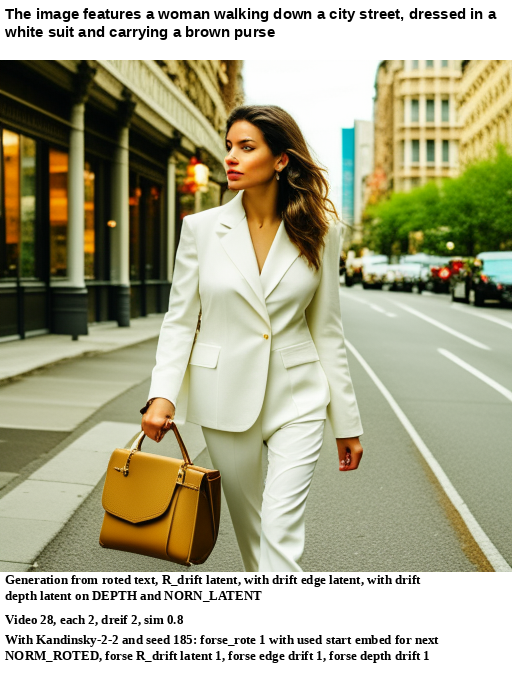

In [ ]:
TEST_PROMPT = used_promt[6] #pare_prompts[0][0]
NEGATIVE_PROMPT = negativ_alls #pare_prompts[0][1]
NUM_STEPS_INF = 50

ROTE_TEXT = True
USE_PREV = False
FORSE_ROTE_TEXT = 1
ROTE_NEG = False
NORM_ROTED = True

FORSE_R_matrix_DRIRT_LATENT = 3

EDGE_LATENT_DRIFT = True
FORSE_ROTE_EDGE = 1
FORSE_EDGE_DRIRT_LATENT = 1

DEPTH_LATENT_DRIFT = True
cls_depth_drift = 1
DEPTH_DRIFT_WITH = ('EDGE','DEPTH', 'EDGE_DEPTH')[cls_depth_drift]
FORSE_ROTE_DEPTH = 1
FORSE_DEPTH_DRIRT_LATENT = 1

NORN_LATENT = True

SEED = 185#

# slice of frames
QTY_CADRS = 24
START_CADR = 0
END_CADR = START_CADR+QTY_CADRS

# Collection Descriptions for images
TEST_MODEL = 'Kandinsky-2-2'
TYPE_EXP = 'Generation from '
ADD_TEXT = ''

if ROTE_TEXT:
  TYPE_EXP += 'roted text'
  ADD_TEXT += f'forse_rote {FORSE_ROTE_TEXT}'
  if ROTE_NEG or NORM_ROTED:  ADD_TEXT += ' with'
  if ROTE_NEG: ADD_TEXT += ' ROTE_NEG'
  if USE_PREV:
    ADD_TEXT += ' used previous embed for next'
  else: ADD_TEXT += ' used start embed for next'
  if ROTE_NEG and NORM_ROTED: ADD_TEXT += ' and'
  if NORM_ROTED: ADD_TEXT += ' NORM_ROTED'

if FORSE_R_matrix_DRIRT_LATENT:
  if ROTE_TEXT:
    TYPE_EXP +=', '
    ADD_TEXT +=', '
  TYPE_EXP += f'R_drift latent'
  ADD_TEXT += f'forse R_drift latent {FORSE_ROTE_EDGE}'

if EDGE_LATENT_DRIFT:
  if ROTE_TEXT or FORSE_R_matrix_DRIRT_LATENT:
    TYPE_EXP +=', '
    ADD_TEXT +=', '
  TYPE_EXP += 'with drift edge latent'
  ADD_TEXT += f'forse edge drift {FORSE_EDGE_DRIRT_LATENT}'

if DEPTH_LATENT_DRIFT:
  if ROTE_TEXT or FORSE_R_matrix_DRIRT_LATENT or EDGE_LATENT_DRIFT:
    TYPE_EXP +=', '
    ADD_TEXT +=', '
  TYPE_EXP += f'with drift depth latent on {DEPTH_DRIFT_WITH}'
  ADD_TEXT += f'forse depth drift {FORSE_DEPTH_DRIRT_LATENT}'

if NORN_LATENT:
  TYPE_EXP+= f' and NORN_LATENT'

bottom_text_1 = f'{TYPE_EXP}'
bottom_text_2 = f'Video {FILM_ID}, each {TAKE_EACH}, dreif {SIZE_DREIF}, sim {COS_SIM}'
bottom_text_3 = f'With {TEST_MODEL} and seed {SEED}: {ADD_TEXT}'
################################################################################


# Initialize start_latents
gen = PixelGenerator(SHAPE_NOISE, SEED, TYPE_TENSORS)
start_latents = gen()


with torch.no_grad():

  # Initialize the Max-pooling layer with kernel 2X2 and stride 2
  #pool = nn.MaxPool2d(kernel_size=260, stride=2, padding=(1,1)).to(DEVICE)
  pool_a = nn.AvgPool2d(kernel_size=260, stride=2, padding=(1,1)).to(DEVICE)
  pool_m = nn.MaxPool2d(kernel_size=769, stride=1).to(DEVICE)


  # получaем новые эмбеддинги на основе переходов между эмбеддингами кадров
  start_embedings = get_start_embegings(TEST_PROMPT, NEGATIVE_PROMPT, NUM_STEPS_INF)
  next_embedings = copy.copy(start_embedings)


  # for collection images
  gen_frames = []
  info_frames = []
  wide_frames = []
  latent_frames = []

  # empty zero for R_latent
  R_latent = np.zeros((1280, 1280))

  for idx in range(len(img_emmbedings[START_CADR:END_CADR])):

    if idx:
      prev_idxs = idx-1 if USE_PREV else 0
      # calculation step R_martix
      R_martix = get_R_martix(img_emmbedings[prev_idxs].astype(np.float32).copy(),
                              img_emmbedings[idx].astype(np.float32).copy(),
                              check = False)

      # sum all earlier step R_martixes for latent
      R_latent = R_latent + R_martix if USE_PREV else R_martix


      if ROTE_TEXT:
          # rote embedings
          prev_embegings = next_embedings if USE_PREV else start_embedings
          next_embedings = get_next_embegings(
                                              base_embegings = prev_embegings,
                                              r_matrix = R_martix,
                                              force = FORSE_ROTE_TEXT,
                                              rote_negative = ROTE_NEG,
                                              norm_roted = NORM_ROTED,
                                              )

      else:  next_embedings = copy.copy(start_embedings)

    # to tensors ####################
    prompt_emb = torch.tensor(next_embedings[0], dtype=TYPE_TENSORS)
    negative_emb = torch.tensor(next_embedings[1], dtype=TYPE_TENSORS)

    # prepare R_martix latent ##################################################
    if not idx: drift_latents = start_latents
    else:
      conc_R_martix = np.concatenate([R_latent[:,:,None] for _ in range(3)],
                                     axis=2).astype(np.float32)
      tenz_R_martix = pool_a(numpy_to_tensor(conc_R_martix).to(DEVICE))
      tenz_R_martix += pool_m(numpy_to_tensor(conc_R_martix).to(DEVICE))
      vae_R_martix = encode_vae(tenz_R_martix.to(DEVICE))

      del(conc_R_martix, tenz_R_martix)
    ############################################################################

    # prepare EDGE_LATENT_DRIFT latent #########################################
    if idx > 1 and EDGE_LATENT_DRIFT:
      # prepare Edge tensors from dif 3 pil frame
      dif_pil = pil_to_tensor(pil_frames[idx-1]) - pil_to_tensor(pil_frames[idx-2])
      orig_edge_1 = encode_vae(lat2edge(dif_pil, cannels=3).to(DEVICE))[0]

      dif_pil = pil_to_tensor(pil_frames[idx]) - pil_to_tensor(pil_frames[idx-1])
      orig_edge_2 = encode_vae(lat2edge(dif_pil, cannels=3).to(DEVICE))[0]

      # prepare Edge tensors from last 2 gen pil frame
      dif_pil = pil_to_tensor(gen_frames[idx-1]) - pil_to_tensor(gen_frames[idx-2])
      gen_edge = encode_vae(lat2edge(dif_pil, cannels=3).to(DEVICE))[0]


      # prepare Edge latent
      roted_edges = []
      for channel, ( ten_1, ten_2) in enumerate(zip(orig_edge_1, orig_edge_2)):
        R_martix_edge = get_R_martix(ten_1.flatten().cpu().numpy().copy(),
                                     ten_2.flatten().cpu().numpy().copy(),
                                     check = False)

        # rote embedings
        next_edges = compute_embed(gen_edge[channel].flatten().cpu().numpy().copy(),
                                   R_martix_edge, force = FORSE_ROTE_EDGE)

        if NORM_ROTED: next_edges = unit_vector(next_edges)

        # collect with convert to 64x64
        roted_edges.append(np.reshape(next_edges, (64,64))[None])

      # convert to latent shape
      roted_latent = np.concatenate(roted_edges, axis = 0).astype(np.float32)
      roted_latent = torch.from_numpy(roted_latent.copy()).unsqueeze(0)


    # prepare DEPTH_LATENT_DRIFT latent #########################################
    if idx > 1 and DEPTH_LATENT_DRIFT:
      # prepare Depth tensors from dif 3 pil frame
      dif_depth = midas(transform(np.array(pil_frames[idx-1])).to(DEVICE))\
      - midas(transform(np.array(pil_frames[idx-2])).to(DEVICE))
      dif_depth = torch.nn.functional.interpolate(
                                                    dif_depth.unsqueeze(1),
                                                    size=(HEIGHT, WIDTH),
                                                    mode="bicubic",
                                                    align_corners=False,
                                                      ).detach().cpu()
      if DEPTH_DRIFT_WITH == "EDGE":
        dif_depth = lat2edge(dif_depth, cannels=3).to(DEVICE)

      elif  DEPTH_DRIFT_WITH == "DEPTH":
        dif_depth = torch.concat([dif_depth for _ in range(3)], axis = 1).to(DEVICE)

      elif  DEPTH_DRIFT_WITH == "EDGE_DEPTH":
        dif_depth_e = lat2edge(dif_depth, cannels=3).to(DEVICE)
        dif_depth_d = torch.concat([dif_depth for _ in range(3)], axis = 1).to(DEVICE)
        dif_depth = dif_depth_e + dif_depth_d

      orig_depth_edge_1 = encode_vae(dif_depth)[0]

      dif_depth= midas(transform(np.array(pil_frames[idx])).to(DEVICE))\
      - midas(transform(np.array(pil_frames[idx-1])).to(DEVICE))
      dif_depth = torch.nn.functional.interpolate(
                                                    dif_depth.unsqueeze(1),
                                                    size=(HEIGHT, WIDTH),
                                                    mode="bicubic",
                                                    align_corners=False,
                                                      ).detach().cpu()

      if DEPTH_DRIFT_WITH == "EDGE":
        dif_depth = lat2edge(dif_depth, cannels=3).to(DEVICE)

      elif  DEPTH_DRIFT_WITH == "DEPTH":
        dif_depth = torch.concat([dif_depth for _ in range(3)], axis = 1).to(DEVICE)

      elif  DEPTH_DRIFT_WITH == "EDGE_DEPTH":
        dif_depth_e = lat2edge(dif_depth, cannels=3).to(DEVICE)
        dif_depth_d = torch.concat([dif_depth for _ in range(3)], axis = 1).to(DEVICE)
        dif_depth = dif_depth_e + dif_depth_d

      orig_depth_edge_2 = encode_vae(dif_depth)[0]

      # prepare Edge tensors from last 2 gen pil frame
      dif_depth = midas(transform(np.array(gen_frames[idx-1])).to(DEVICE))\
      - midas(transform(np.array(gen_frames[idx-2])).to(DEVICE))
      dif_depth = torch.nn.functional.interpolate(
                                                    dif_depth.unsqueeze(1),
                                                    size=(HEIGHT, WIDTH),
                                                    mode="bicubic",
                                                    align_corners=False,
                                                      ).detach().cpu()
      if DEPTH_DRIFT_WITH == "EDGE":
        dif_depth = lat2edge(dif_depth, cannels=3).to(DEVICE)

      elif  DEPTH_DRIFT_WITH == "DEPTH":
        dif_depth = torch.concat([dif_depth for _ in range(3)], axis = 1).to(DEVICE)

      elif  DEPTH_DRIFT_WITH == "EDGE_DEPTH":
        dif_depth_e = lat2edge(dif_depth, cannels=3).to(DEVICE)
        dif_depth_d = torch.concat([dif_depth for _ in range(3)], axis = 1).to(DEVICE)
        dif_depth = dif_depth_e + dif_depth_d


      gen_depth_edge = encode_vae(dif_depth.to(DEVICE))[0]


      # prepare Edge latent
      roted_depth_edges = []
      for channel, ( ten_1, ten_2) in enumerate(zip(orig_depth_edge_1, orig_depth_edge_2)):
        R_martix_depth_edge = get_R_martix(ten_1.flatten().cpu().numpy().copy(),
                                      ten_2.flatten().cpu().numpy().copy(),
                                      check = False)

        # rote embedings
        next_depth_edges = compute_embed(gen_depth_edge[channel].flatten().cpu().numpy().copy(),
                                    R_martix_depth_edge, force = FORSE_ROTE_DEPTH)
        if NORM_ROTED: next_depth_edges = unit_vector(next_depth_edges)

        # collect with convert to 64x64
        roted_depth_edges.append(np.reshape(next_depth_edges,(64,64))[None])

      # convert to latent shape
      roted_depth_latent = np.concatenate(roted_depth_edges, axis = 0).astype(np.float32)
      roted_depth_latent = torch.from_numpy(roted_depth_latent.copy()).unsqueeze(0)



    # collected latent #####################################################
    if idx:
      drift_latents += FORSE_R_matrix_DRIRT_LATENT*vae_R_martix.clone()
      del(vae_R_martix)

    if idx > 1 and EDGE_LATENT_DRIFT:
      drift_latents += FORSE_EDGE_DRIRT_LATENT*roted_latent
      del(roted_latent)
    if idx > 1 and DEPTH_LATENT_DRIFT:
      drift_latents += FORSE_DEPTH_DRIRT_LATENT*roted_depth_latent
      del(roted_depth_latent)

    if NORN_LATENT:
      drift_latents = F.normalize(drift_latents.clone(), p=2, dim=3)

    # pil pf step latents
    view_latent = decode_latents(drift_latents.clone().to(torch.float32).to(DEVICE))[0]

    # generate from latent #####################################################
    results_T2I = decoder_T2I(
                        image_embeds = prompt_emb.to(DEVICE),
                        negative_image_embeds = negative_emb.to(DEVICE),
                        num_inference_steps=NUM_STEPS_INF,
                        generator = torch.manual_seed(SEED),
                        latents = drift_latents.to(TYPE_TENSORS).to(DEVICE),
                        height=HEIGHT,
                        width=WIDTH)

    # add titles and output view ###############################################
    # splite big title
    width_title = 68
    width_others = 80
    wrapper = textwrap.TextWrapper(width=width_title)
    word_list = wrapper.wrap(text=TEST_PROMPT)
    title_text = ''
    for ii in word_list[:-1]:
        title_text = title_text + ii + '\n'
    title_text += word_list[-1]

    # take base img
    base_img = copy.copy(results_T2I[0][0])
    PAD = 180 # init variant
    douwn_farme = 130 # place for down imge informatio
    top_frame = PAD - douwn_farme

    # make init temp_img background image
    temp_img = PIL.Image.new("RGBA", (WIDTH, HEIGHT+PAD), color='white')
    img_pos = PAD + 10 - douwn_farme
    temp_img.paste(base_img,(0, img_pos))
    draw = PIL.ImageDraw.Draw(temp_img)

    # calculate place for title
    position = (5, 5)
    left, top, right, bottom = draw.textbbox(position, title_text, font=FONT_TITLE)

    # if place bigger than PAD + 10 - douwn_farme
    if bottom+5 > PAD + 10 - douwn_farme:
        top_frame = bottom+10
        PAD = top_frame + douwn_farme #update PAD

        # make new temp_img
        temp_img = PIL.Image.new("RGBA", (WIDTH, HEIGHT+PAD), color='white')
        img_pos = top_frame
        temp_img.paste(base_img,(0, img_pos))
        draw = PIL.ImageDraw.Draw(temp_img)

    draw.text(position, title_text, font=FONT_TITLE, fill="black")

    # splite bottom_text_1
    wrapper = textwrap.TextWrapper(width=width_others)
    word_list = wrapper.wrap(text=bottom_text_1)
    caption_text_1 = ''
    for ii in word_list[:-1]:
        caption_text_1 = caption_text_1+ ii + '\n'
    caption_text_1 += word_list[-1]

    # splite bottom_text_3
    wrapper = textwrap.TextWrapper(width=width_others)
    word_list = wrapper.wrap(text=bottom_text_3)
    caption_text_3 = ''
    for ii in word_list[:-1]:
        caption_text_3 = caption_text_3 + ii + '\n'
    caption_text_3 += word_list[-1]

    # calculate place and draw down descriptions ror images
    position = (5, HEIGHT - 120 + PAD)
    left, top, right, bottom = draw.textbbox(position, caption_text_1, font=FONT_ADD)
    draw.text(position, caption_text_1, font=FONT_ADD, fill="black")

    position = (5, HEIGHT- 80 + PAD)
    left, top, right, bottom = draw.textbbox(position, bottom_text_2, font=FONT_ADD)
    draw.text(position, bottom_text_2, font=FONT_ADD, fill="black")

    position = (5, HEIGHT- 60 + PAD)
    left, top, right, bottom = draw.textbbox(position, caption_text_3, font=FONT_ADD)
    draw.text(position, caption_text_3, font=FONT_ADD, fill="black")
    del(draw)
    wide_img = PIL.Image.new("RGBA", (2*WIDTH+10, HEIGHT+PAD), color='white')
    wide_img.paste(temp_img,(0, 0))
    wide_img.paste(pil_frames[idx],(WIDTH+10, img_pos))
    draw = PIL.ImageDraw.Draw(wide_img)
    position = (4*WIDTH//3 - 5, img_pos -30)
    discription = "Move frames for rote and dreif"
    left, top, right, bottom = draw.textbbox(position, discription, font=FONT_TITLE)
    draw.text(position, discription, font=FONT_TITLE, fill="black")
    if idx:
      position = (15 + WIDTH, HEIGHT - 80 + PAD)
      discription = f"similirity to start_emb = {sim2start[idx]}\nsimilirity to prev_emb = {sim2prev[idx]}"
      left, top, right, bottom = draw.textbbox(position, discription, font=FONT_TITLE)
      draw.text(position, discription, font=FONT_TITLE, fill="black")

    noise_img = PIL.Image.new("RGBA", (2*WIDTH+10, HEIGHT+PAD), color='white')
    noise_img.paste(temp_img,(0, 0))
    noise_img.paste(view_latent,(WIDTH+10, img_pos))
    draw = PIL.ImageDraw.Draw(noise_img)
    position = (4*WIDTH//3 - 5, img_pos -30)
    discription = "Modificated latent noise"
    left, top, right, bottom = draw.textbbox(position, discription, font=FONT_TITLE)
    draw.text(position, discription, font=FONT_TITLE, fill="black")
    if idx:
      position = (15 + WIDTH, HEIGHT - 80 + PAD)
      discription = f"similirity to start_emb = {sim2start[idx]}\nsimilirity to prev_emb = {sim2prev[idx]}"
      left, top, right, bottom = draw.textbbox(position, discription, font=FONT_TITLE)
      draw.text(position, discription, font=FONT_TITLE, fill="black")

    # append and del temp  #####################################################
    gen_frames.append(base_img)
    info_frames.append(temp_img)
    wide_frames.append(wide_img)
    latent_frames.append(noise_img)

    # clear memory  ############################################################
    del(temp_img, base_img, wide_img, draw, position, left, top, right, bottom)
    del(results_T2I, prompt_emb, negative_emb, view_latent)
    gc.collect()
    torch.cuda.empty_cache()

info_frames[0]

##Визулизации

The image features a woman walking down a city street, dressed in a white suit and carrying a brown purse




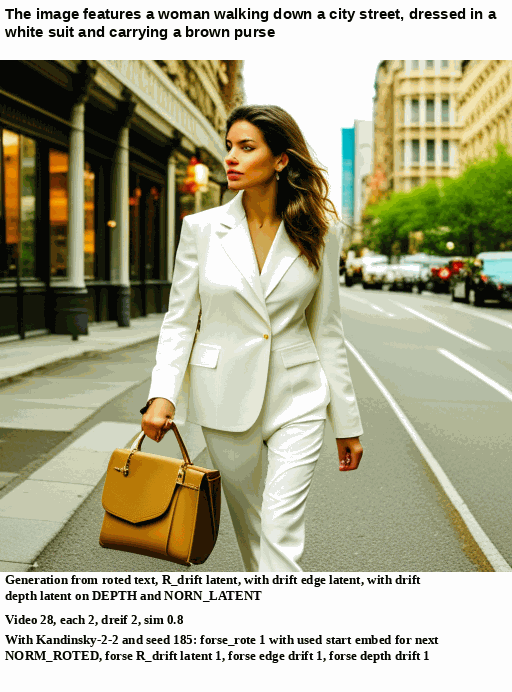

In [ ]:
test = 2
start_id = 0
print(TEST_PROMPT)
print()
BASE_PATH = '/content/drive/Othercomputers/My_comp/Документы/МФТИ_Наука_о_данных/ВКР_Гончаренко/Tests/'
OUT_DIR = f'{BASE_PATH}/gifs/{TYPE_EXP}_{TEST_MODEL}_{FILM_ID}_each_{TAKE_EACH}_test_{test}.gif'
make_gif(set_dir_pil = info_frames[start_id:],
         out_name = OUT_DIR,
         duration = 250,
         loop = 0,
         )

show_gif(OUT_DIR)

##Визулизации wide

The image features a woman walking down a city street, dressed in a white suit and carrying a brown purse




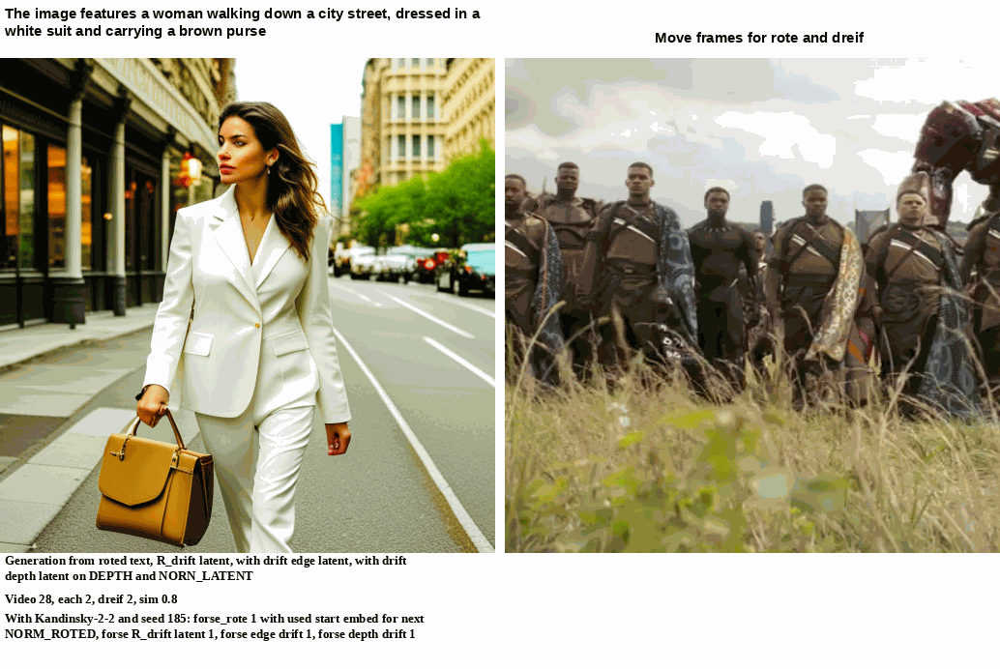

In [ ]:
print(TEST_PROMPT)
print()
BASE_PATH = '/content/drive/Othercomputers/My_comp/Документы/МФТИ_Наука_о_данных/ВКР_Гончаренко/Tests/'
OUT_DIR = f"{BASE_PATH}/gifs/width_frames/{TEST_MODEL}_{FILM_ID}_each_{TAKE_EACH}_{ADD_TEXT}_test_{test}.gif"
make_gif(set_dir_pil = wide_frames[start_id:],
         out_name = OUT_DIR,
         duration = 250,
         loop = 0,
         )

show_gif(OUT_DIR)

##Визулизации latent

The image features a woman walking down a city street, dressed in a white suit and carrying a brown purse




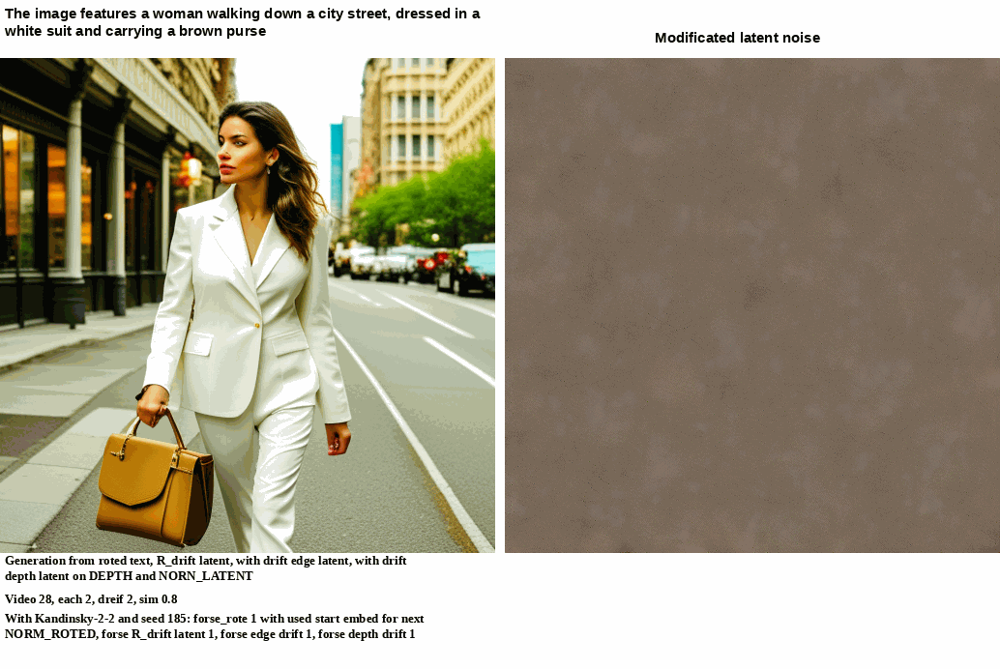

In [ ]:
print(TEST_PROMPT)
print()
BASE_PATH = '/content/drive/Othercomputers/My_comp/Документы/МФТИ_Наука_о_данных/ВКР_Гончаренко/Tests/'
OUT_DIR = f"{BASE_PATH}/gifs/noise_frames/{TEST_MODEL}_{FILM_ID}_each_{TAKE_EACH}_{ADD_TEXT}_test_{test}.gif"
make_gif(set_dir_pil = latent_frames[start_id:],
         out_name = OUT_DIR,
         duration = 250,
         loop = 0,
         )

show_gif(OUT_DIR)

woman wearing a strapless black top + eye contact + full body pose arms crossed on her chest + blonde hair and dark-green eyes + candlelight and intimate setting + oil painting style + lots of detail + very detailed shadows




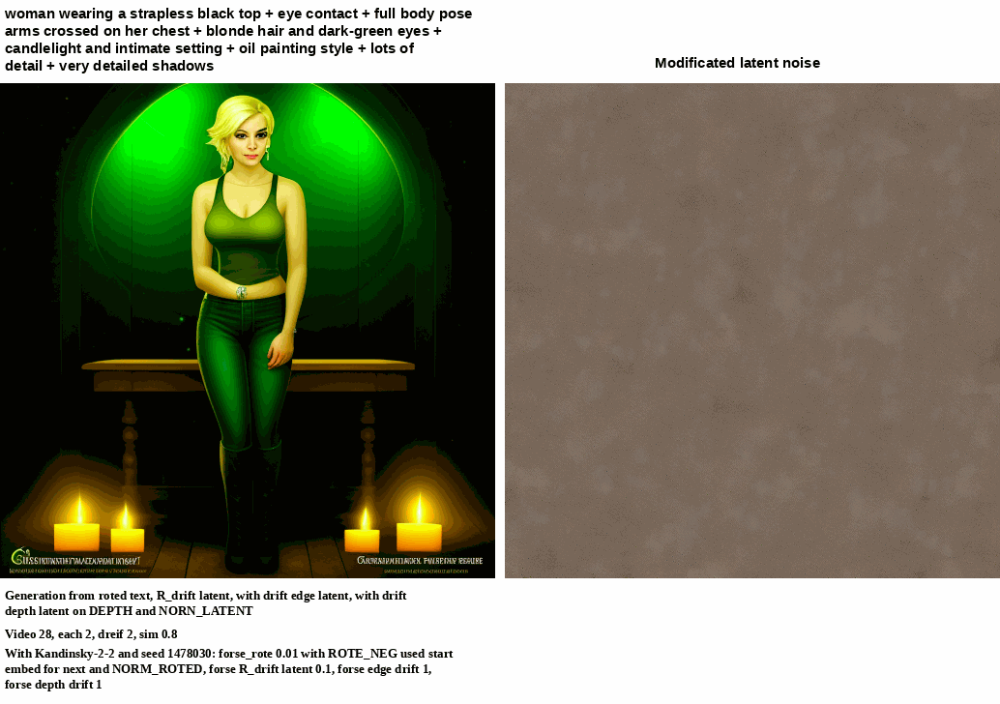

In [ ]:
print(TEST_PROMPT)
print()
BASE_PATH = '/content/drive/Othercomputers/My_comp/Документы/МФТИ_Наука_о_данных/ВКР_Гончаренко/Tests/'
OUT_DIR = f"{BASE_PATH}/gifs/noise_frames/{TEST_MODEL}_{FILM_ID}_each_{TAKE_EACH}_{ADD_TEXT}_test_{test}.gif"
make_gif(set_dir_pil = latent_frames[start_id:],
         out_name = OUT_DIR,
         duration = 250,
         loop = 0,
         )

show_gif(OUT_DIR)